# VERSO Step#2
# Application to Dataset #1 (Amplicon sequencing data)

# Article: "Quantification of intra-host genomic diversity of SARS-CoV-2 allows a high-resolution characterization of viral evolution and reveals functionally convergent variants"
# Authors Daniele Ramazzotti, Fabrizio Angaroni, Davide Maspero, Carlo Gambacorti-Passerini, Marco Antoniotti, Alex Graudenzi and Rocco Piazza
# Preprint available at : https://www.biorxiv.org/content/10.1101/2020.04.22.044404v2
# Correspondence: alex.graudenzi@ibfm.cnr.it, rocco.piazza@unimib.it

In [1]:
#Please run all the commands included in the Jupyter notebook to reproduce the analysis of 
#Dataset #1 via VERSO STEP #2

# Loading the libraries

In [2]:
# No actions are required at this step, please just run the notebook 
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

import os
os.chdir(os.getcwd())
os.getcwd()

import dill
import pickle
import gc
gc.collect()
pickle.HIGHEST_PROTOCOL

import scanpy as sc
import leidenalg
import scanpy.external as sce
import numpy as np
import scipy as sp
from scipy.stats import norm
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.axes as axxx
from matplotlib import rcParams
from matplotlib import colors
import seaborn as sb
import anndata as an
from scipy import sparse
from pybiomart import Dataset

plt.rcParams['figure.figsize']=(8,8) #rescale figures
sc.settings.verbosity = 3
sc.set_figure_params(dpi=400, dpi_save=500)
#sc.logging.print_versions()

import matplotlib.cm as cm

def colormap(fig,nax):
    ax1=fig.get_axes()[nax]
    clim=ax1.get_children()[0].get_clim()
    cnorm=colors.Normalize(clim[0],clim[1])
    fig.colorbar(cm.ScalarMappable(norm=cnorm, cmap=None), ax=ax1)
    fig.delaxes(fig.get_axes()[-2])

## Input data

In [3]:
# Please LOAD the INPUT FILES

#(A)
input_data_matrix_filename = "VF_matrix_Amplicon_dataset.csv"

#(B)
samples_info_matrix_filename = "samples_info_Amplicon_dataset.txt"

#(C)
variants_info_matrix_filename = "variants_info_Amplicon_dataset.txt"

In [4]:
#defining the data structures
data_all = pd.read_csv(input_data_matrix_filename, header=0, sep=',')
assignments = pd.read_csv(samples_info_matrix_filename, header=0, sep='\t')
metadata = pd.read_csv(variants_info_matrix_filename, header=0, sep='\t')

data_all.set_index("Unnamed: 0", drop=True, inplace=True)
assignments.set_index("Unnamed: 0", drop=True, inplace=True)
metadata.set_index("Unnamed: 0", drop=True, inplace=True)

adata_all=an.AnnData(data_all.T)
adata_all.var_names_make_unique()
adata_all.obs_names_make_unique()

adata_all.obs['Genotype'] = 'NA'
adata_all.obs['Outlier'] = 'NA'
adata_all.obs['Contact_group'] = 'NA'
adata_all.obs['Week'] = 'NA'


adata_all.obs['Genotype'][:] = assignments['Cluster']
adata_all.obs['Outlier'][:] = assignments['outlier']
adata_all.obs['Contact_group'][:] = assignments['Epi']
adata_all.obs['Week'][:] = assignments['week']

adata_all

/Users/alexgraudenzi/miniconda3/lib/python3.6/site-packages/ipykernel_launcher.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/Users/alexgraudenzi/miniconda3/lib/python3.6/site-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/Users/alexgraudenzi/miniconda3/lib/python3.6/site-packages/ipykernel_launcher.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


AnnData object with n_obs × n_vars = 3029 × 15892
    obs: 'Genotype', 'Outlier', 'Contact_group', 'Week'

In [5]:
#selecting only the variants present in the dataset and those observed in at most 1 clonal genotype, 
#excluding the clonal variants employed in the reconstruction of the phylogenetic tree via VERSO STEP #1
list_variants_no_homoplasy = metadata[metadata['nCluster']<2].index
list_variants_no_clonal = metadata[metadata['inference']==0].index
index_final_variants = list_variants_no_homoplasy.intersection(list_variants_no_clonal)

adata_all_subset_variants = adata_all[:, index_final_variants]
adata_all_subset_variants

/Users/alexgraudenzi/miniconda3/lib/python3.6/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


View of AnnData object with n_obs × n_vars = 3029 × 7980
    obs: 'Genotype', 'Outlier', 'Contact_group', 'Week'

In [6]:
#selecting only the samples that are NOT outliers (with <100 minor variants)
adata_all_subset_variants_samples = adata_all_subset_variants[adata_all_subset_variants.obs['Outlier']==0].copy()
adata_all_subset_variants_samples

/Users/alexgraudenzi/miniconda3/lib/python3.6/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


AnnData object with n_obs × n_vars = 2908 × 7980
    obs: 'Genotype', 'Outlier', 'Contact_group', 'Week'

25

C01
computing PCA
    with n_comps=10
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 10
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:04)
running Leiden clustering
    finished: found 6 clusters and added
    'groups', the cluster labels (adata.obs, categorical) (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:00)


/Users/alexgraudenzi/miniconda3/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])
... storing 'Genotype' as categorical
... storing 'Contact_group' as categorical


<AxesSubplot:title={'center':'Dataset #1 - Genotype 01 (n = 86)'}, xlabel='UMAP1', ylabel='UMAP2'>

writing .csv files to outputC01


C02
C03
computing PCA
    with n_comps=10
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 10
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
running Leiden clustering
    finished: found 8 clusters and added
    'groups', the cluster labels (adata.obs, categorical) (0:00:00)
computing UMAP


/Users/alexgraudenzi/miniconda3/lib/python3.6/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:00)


/Users/alexgraudenzi/miniconda3/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])
... storing 'Genotype' as categorical
... storing 'Contact_group' as categorical


<AxesSubplot:title={'center':'Dataset #1 - Genotype 03 (n = 103)'}, xlabel='UMAP1', ylabel='UMAP2'>

writing .csv files to outputC03


C04
computing PCA
    with n_comps=10
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 10
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
running Leiden clustering
    finished: found 6 clusters and added
    'groups', the cluster labels (adata.obs, categorical) (0:00:00)
computing UMAP


/Users/alexgraudenzi/miniconda3/lib/python3.6/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:00)


/Users/alexgraudenzi/miniconda3/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])
... storing 'Genotype' as categorical
... storing 'Contact_group' as categorical


<AxesSubplot:title={'center':'Dataset #1 - Genotype 04 (n = 86)'}, xlabel='UMAP1', ylabel='UMAP2'>

writing .csv files to outputC04


C05
C06
computing PCA
    with n_comps=10
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 10
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
running Leiden clustering
    finished: found 6 clusters and added
    'groups', the cluster labels (adata.obs, categorical) (0:00:00)
computing UMAP


/Users/alexgraudenzi/miniconda3/lib/python3.6/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:00)


/Users/alexgraudenzi/miniconda3/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])
... storing 'Genotype' as categorical
... storing 'Contact_group' as categorical


<AxesSubplot:title={'center':'Dataset #1 - Genotype 06 (n = 74)'}, xlabel='UMAP1', ylabel='UMAP2'>

writing .csv files to outputC06


C07
C08
computing PCA
    with n_comps=10
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 10
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
running Leiden clustering
    finished: found 5 clusters and added
    'groups', the cluster labels (adata.obs, categorical) (0:00:00)
computing UMAP


/Users/alexgraudenzi/miniconda3/lib/python3.6/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:00)


/Users/alexgraudenzi/miniconda3/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])
... storing 'Genotype' as categorical
... storing 'Contact_group' as categorical


<AxesSubplot:title={'center':'Dataset #1 - Genotype 08 (n = 72)'}, xlabel='UMAP1', ylabel='UMAP2'>

writing .csv files to outputC08


C09
C10
computing PCA
    with n_comps=10
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 10
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
running Leiden clustering
    finished: found 11 clusters and added
    'groups', the cluster labels (adata.obs, categorical) (0:00:00)
computing UMAP


/Users/alexgraudenzi/miniconda3/lib/python3.6/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:00)


/Users/alexgraudenzi/miniconda3/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])
... storing 'Genotype' as categorical
... storing 'Contact_group' as categorical


<AxesSubplot:title={'center':'Dataset #1 - Genotype 10 (n = 139)'}, xlabel='UMAP1', ylabel='UMAP2'>

writing .csv files to outputC10


C11
C12
computing PCA
    with n_comps=10
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 10
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
running Leiden clustering
    finished: found 9 clusters and added
    'groups', the cluster labels (adata.obs, categorical) (0:00:00)
computing UMAP


/Users/alexgraudenzi/miniconda3/lib/python3.6/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:00)


/Users/alexgraudenzi/miniconda3/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])
... storing 'Genotype' as categorical
... storing 'Contact_group' as categorical


<AxesSubplot:title={'center':'Dataset #1 - Genotype 12 (n = 115)'}, xlabel='UMAP1', ylabel='UMAP2'>

writing .csv files to outputC12


C13
C14
C15
computing PCA
    with n_comps=10


/Users/alexgraudenzi/miniconda3/lib/python3.6/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 10
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
running Leiden clustering
    finished: found 21 clusters and added
    'groups', the cluster labels (adata.obs, categorical) (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:00)


/Users/alexgraudenzi/miniconda3/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])
... storing 'Genotype' as categorical
... storing 'Contact_group' as categorical


<AxesSubplot:title={'center':'Dataset #1 - Genotype 15 (n = 493)'}, xlabel='UMAP1', ylabel='UMAP2'>

writing .csv files to outputC15
/Users/alexgraudenzi/miniconda3/lib/python3.6/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


C16
C17
computing PCA
    with n_comps=10
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 10
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
running Leiden clustering
    finished: found 29 clusters and added
    'groups', the cluster labels (adata.obs, categorical) (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:00)


/Users/alexgraudenzi/miniconda3/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])
... storing 'Genotype' as categorical
... storing 'Contact_group' as categorical


<AxesSubplot:title={'center':'Dataset #1 - Genotype 17 (n = 512)'}, xlabel='UMAP1', ylabel='UMAP2'>

writing .csv files to outputC17


C18
computing PCA
    with n_comps=10
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 10


/Users/alexgraudenzi/miniconda3/lib/python3.6/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
running Leiden clustering
    finished: found 3 clusters and added
    'groups', the cluster labels (adata.obs, categorical) (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:00)


/Users/alexgraudenzi/miniconda3/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])
... storing 'Genotype' as categorical
... storing 'Contact_group' as categorical


<AxesSubplot:title={'center':'Dataset #1 - Genotype 18 (n = 25)'}, xlabel='UMAP1', ylabel='UMAP2'>

writing .csv files to outputC18


C19
computing PCA
    with n_comps=10
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 10
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
running Leiden clustering
    finished: found 8 clusters and added
    'groups', the cluster labels (adata.obs, categorical) (0:00:00)
computing UMAP


/Users/alexgraudenzi/miniconda3/lib/python3.6/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:00)


/Users/alexgraudenzi/miniconda3/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])
... storing 'Genotype' as categorical
... storing 'Contact_group' as categorical


<AxesSubplot:title={'center':'Dataset #1 - Genotype 19 (n = 118)'}, xlabel='UMAP1', ylabel='UMAP2'>

writing .csv files to outputC19


C20
computing PCA
    with n_comps=10
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 10
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
running Leiden clustering
    finished: found 8 clusters and added
    'groups', the cluster labels (adata.obs, categorical) (0:00:00)
computing UMAP


/Users/alexgraudenzi/miniconda3/lib/python3.6/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:00)


/Users/alexgraudenzi/miniconda3/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])
... storing 'Genotype' as categorical
... storing 'Contact_group' as categorical


<AxesSubplot:title={'center':'Dataset #1 - Genotype 20 (n = 94)'}, xlabel='UMAP1', ylabel='UMAP2'>

writing .csv files to outputC20


C21
computing PCA
    with n_comps=10


/Users/alexgraudenzi/miniconda3/lib/python3.6/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 10
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
running Leiden clustering
    finished: found 28 clusters and added
    'groups', the cluster labels (adata.obs, categorical) (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


/Users/alexgraudenzi/miniconda3/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])
... storing 'Genotype' as categorical
... storing 'Contact_group' as categorical


<AxesSubplot:title={'center':'Dataset #1 - Genotype 21 (n = 648)'}, xlabel='UMAP1', ylabel='UMAP2'>

writing .csv files to outputC21


C22
computing PCA
    with n_comps=10
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 10
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
running Leiden clustering
    finished: found 7 clusters and added
    'groups', the cluster labels (adata.obs, categorical) (0:00:00)
computing UMAP


/Users/alexgraudenzi/miniconda3/lib/python3.6/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:00)


/Users/alexgraudenzi/miniconda3/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])
... storing 'Genotype' as categorical
... storing 'Contact_group' as categorical


<AxesSubplot:title={'center':'Dataset #1 - Genotype 22 (n = 90)'}, xlabel='UMAP1', ylabel='UMAP2'>

writing .csv files to outputC22


C23
computing PCA
    with n_comps=10
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 10
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
running Leiden clustering
    finished: found 10 clusters and added
    'groups', the cluster labels (adata.obs, categorical) (0:00:00)
computing UMAP


/Users/alexgraudenzi/miniconda3/lib/python3.6/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:00)


/Users/alexgraudenzi/miniconda3/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])
... storing 'Genotype' as categorical
... storing 'Contact_group' as categorical


<AxesSubplot:title={'center':'Dataset #1 - Genotype 23 (n = 127)'}, xlabel='UMAP1', ylabel='UMAP2'>

writing .csv files to outputC23


C24
C25
computing PCA
    with n_comps=10
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 10
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
running Leiden clustering
    finished: found 7 clusters and added
    'groups', the cluster labels (adata.obs, categorical) (0:00:00)
computing UMAP


/Users/alexgraudenzi/miniconda3/lib/python3.6/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:00)


/Users/alexgraudenzi/miniconda3/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])
... storing 'Genotype' as categorical
... storing 'Contact_group' as categorical


<AxesSubplot:title={'center':'Dataset #1 - Genotype 25 (n = 86)'}, xlabel='UMAP1', ylabel='UMAP2'>

writing .csv files to outputC25


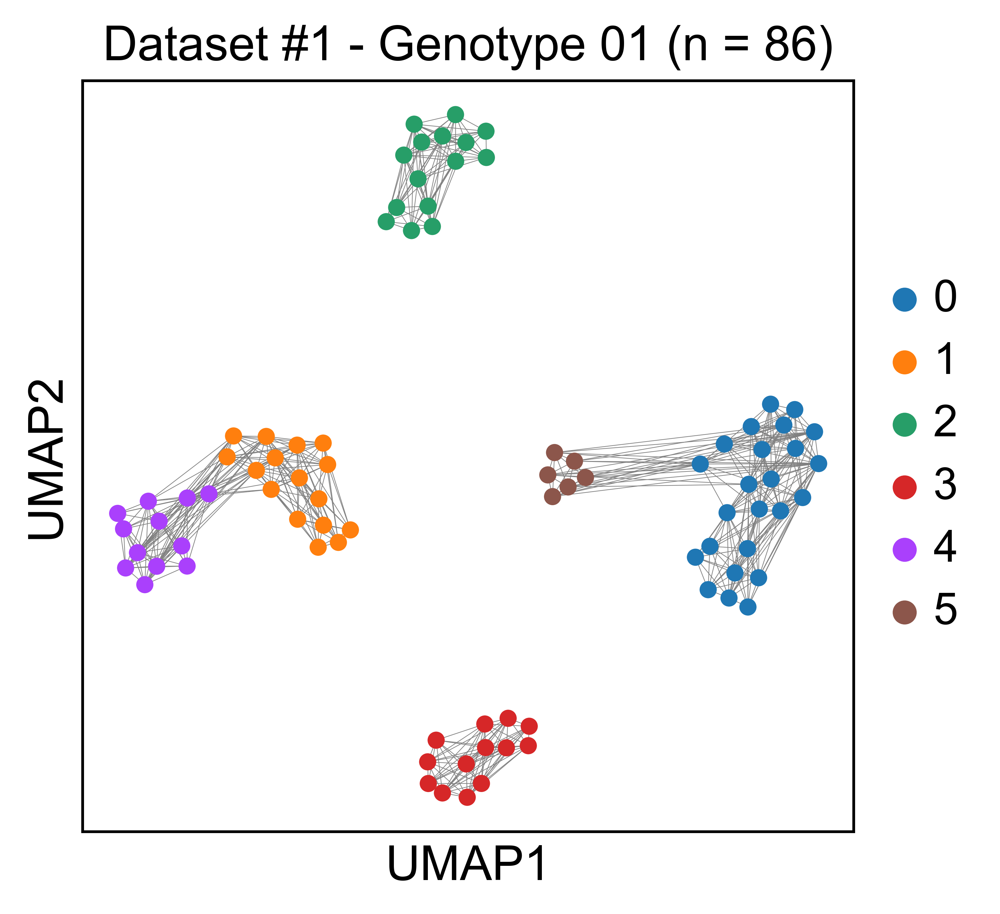

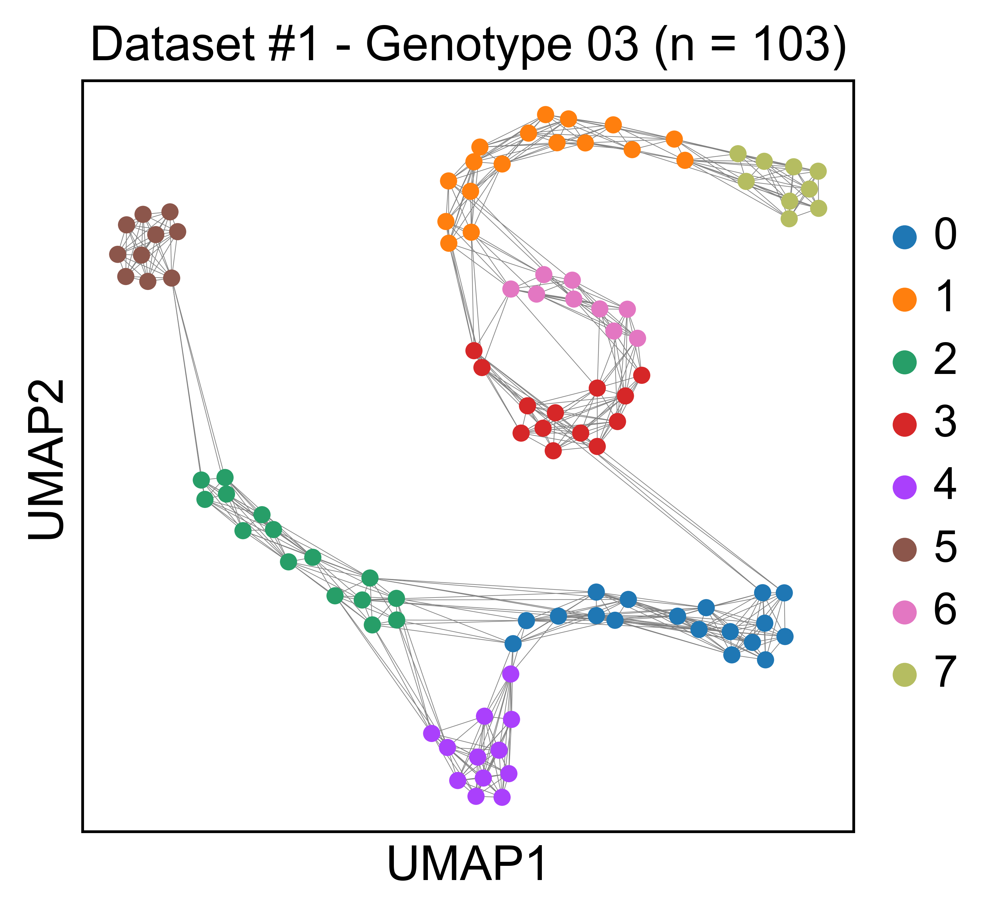

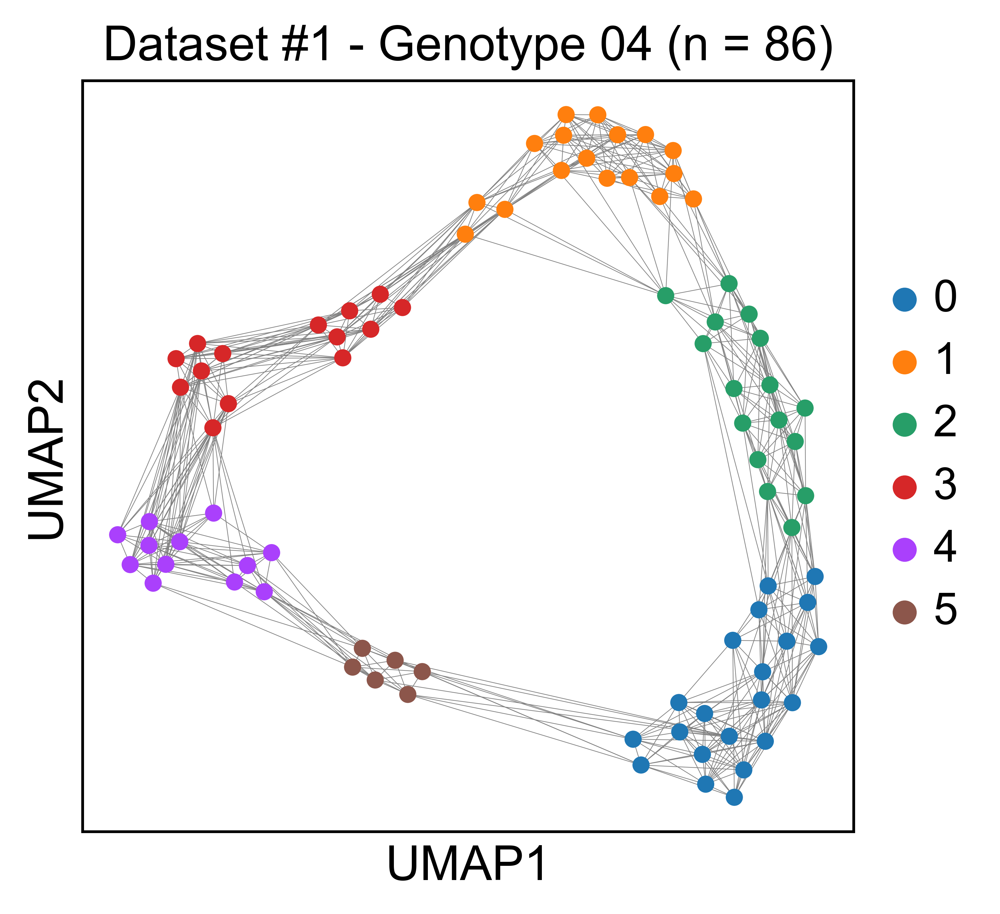

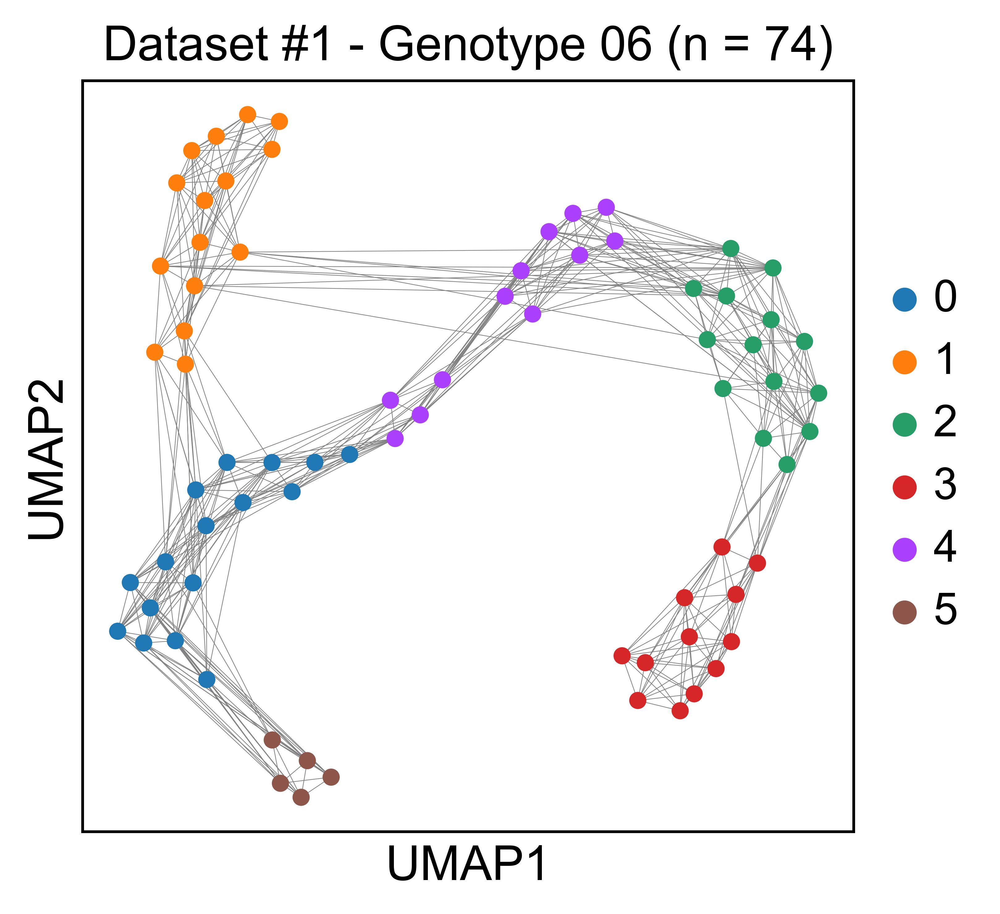

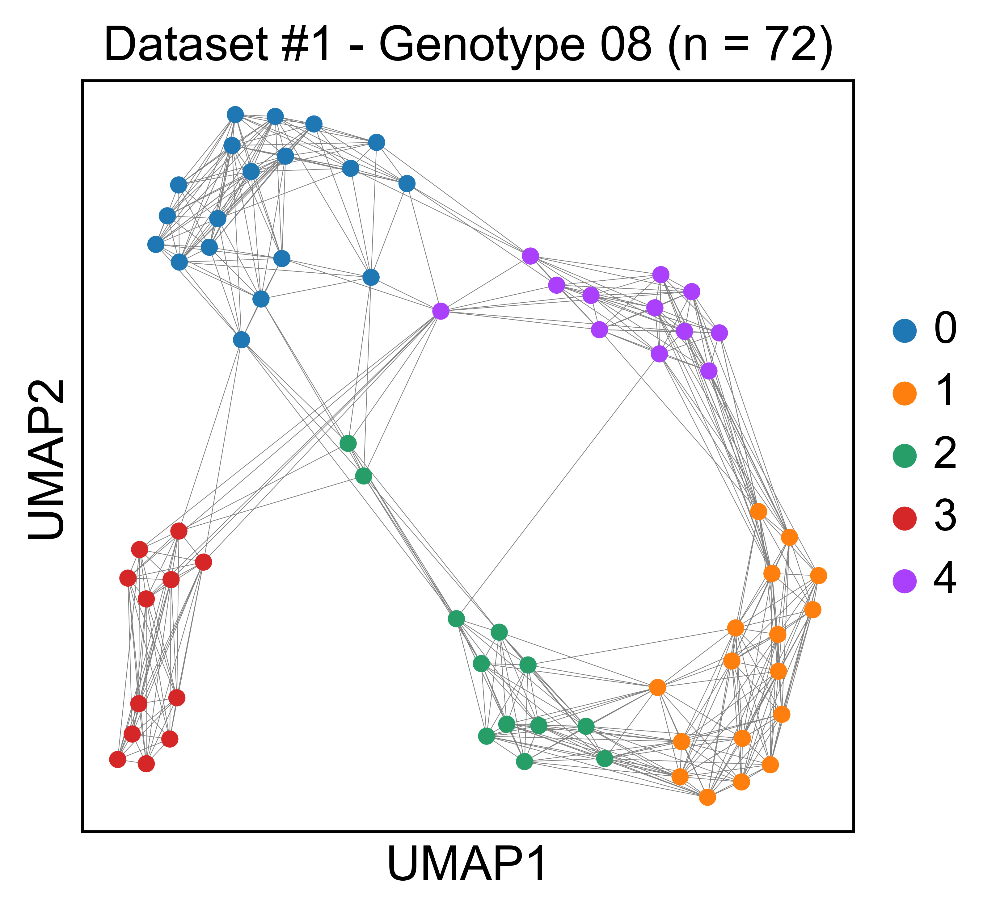

...

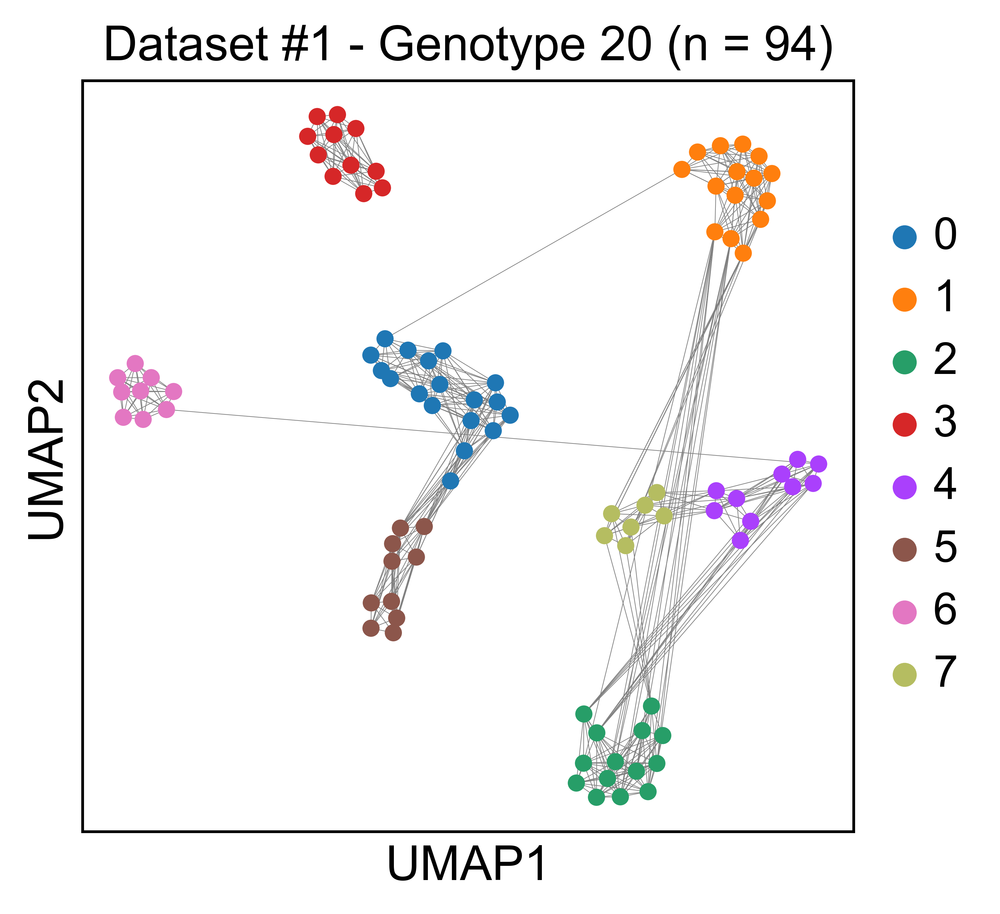

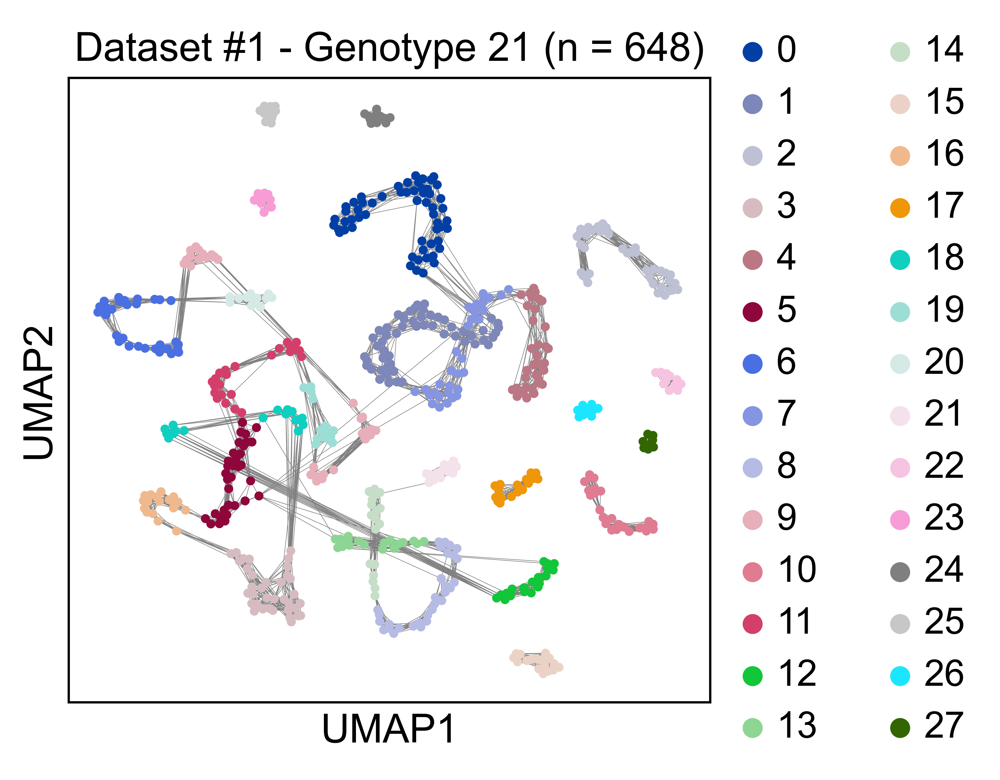

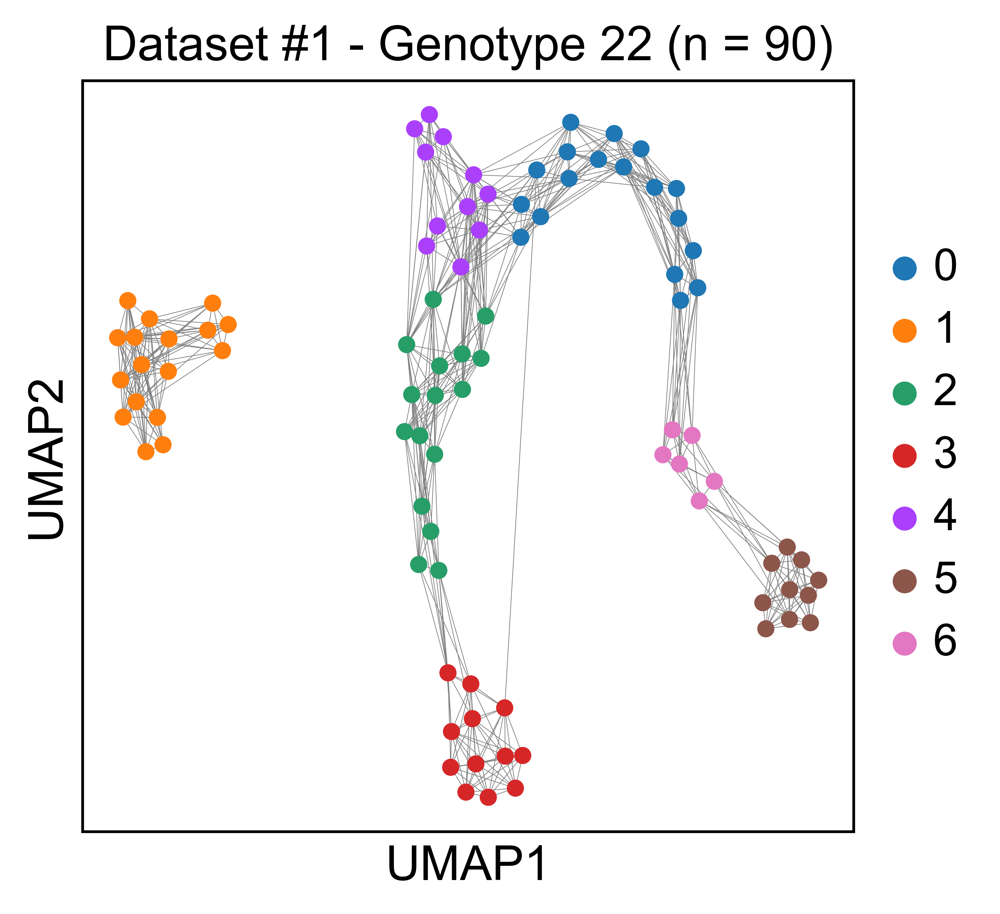

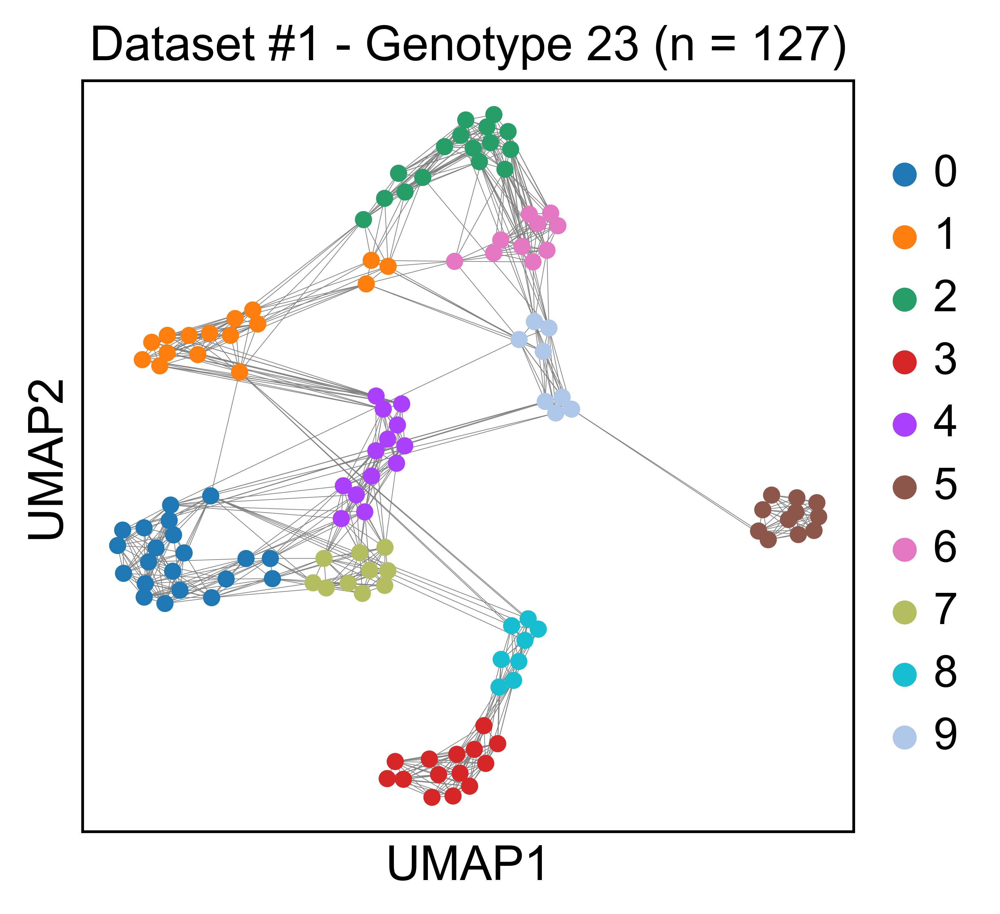

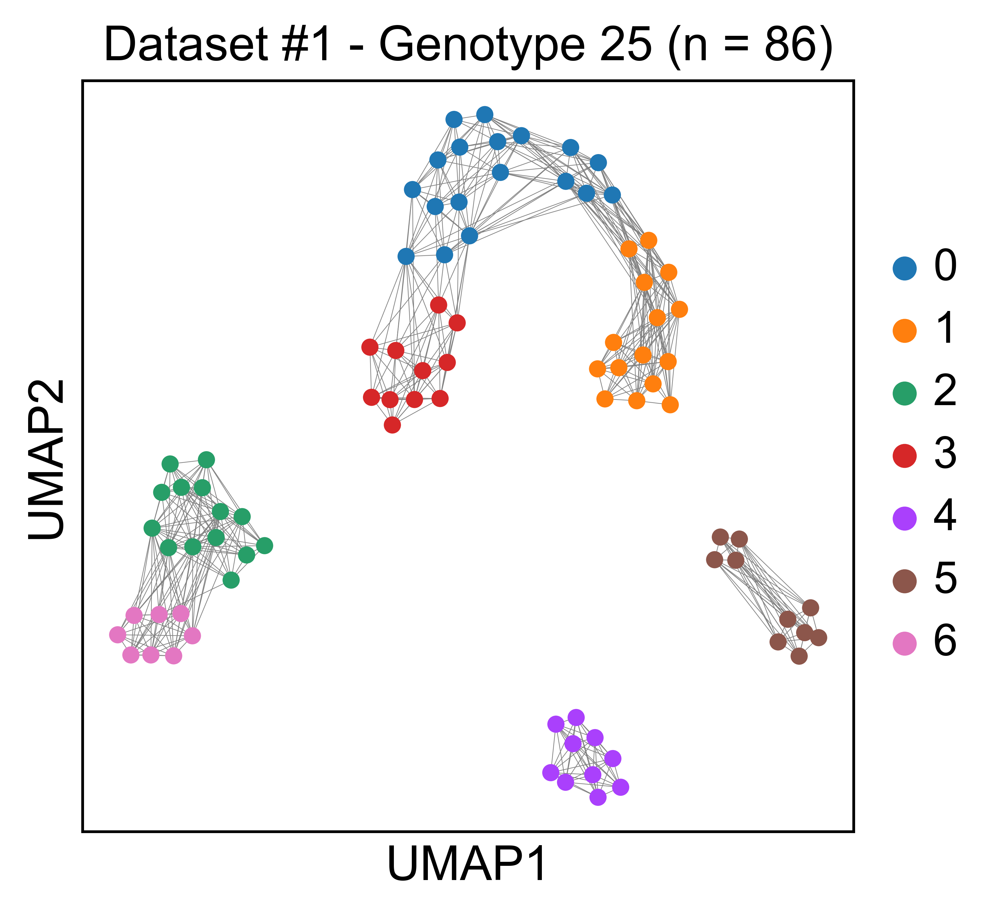

In [7]:
#performing VERSO STEP #2 on all clonal genotypes
how_many_clusters = len(np.unique(adata_all_subset_variants_samples.obs['Genotype']))
how_many_clusters
for x in range(how_many_clusters):

    y = x + 1
    if y<10:
        print('C'+ str(0)+str(y))
        temp = ('C'+ str(0)+str(y))
        temp_title = ('Dataset #1 - Genotype '+ str(0)+str(y))
    else: 
        print('C'+str(y))
        temp = ('C'+str(y))
        temp_title = ('Dataset #1 - Genotype '+str(y))
        
    adata_all_cluster = adata_all_subset_variants_samples[adata_all_subset_variants_samples.obs['Genotype'] == temp].copy()
    
    how_many_samples = len(adata_all_cluster.obs)
    temp_title = temp_title + ' (n = '+ str(how_many_samples) +')'
    
    how_many_variables = len(adata_all_cluster.var)
    
    if how_many_samples > 20:
        number_of_neighbours_to_be_used = 10
        number_of_PCA = 10
        
        sc.pp.pca(adata_all_cluster, n_comps=10,zero_center = 'False',random_state=1)       
        sc.pp.neighbors(adata_all_cluster, knn = 'TRUE', n_pcs = number_of_PCA, 
                        n_neighbors=number_of_neighbours_to_be_used,random_state=1,
                        metric = 'braycurtis', method = "umap")
        sc.tl.leiden(adata_all_cluster, key_added='groups', random_state=1,resolution = 1)

        sc.tl.umap(adata_all_cluster, random_state=1, a = 0.01, b = 1, spread = 1, min_dist = 2)

        temp_file = temp+'.svg'
        temp_output = 'output'+temp+'.csv'
        temp_file_distances = temp+'_distances.txt'

        if how_many_samples > 500:
            size_nodes = 40
        if how_many_samples <= 500:
            size_nodes = 100
        sc.pl.umap(adata_all_cluster, color=['groups'], legend_loc='right margin', edges = 'TRUE', edges_width = 0.2, size = size_nodes,  title = temp_title , show=False)       
        #to visualize the contact information on the UMAP plots, uncomment the following line
        # sc.pl.umap(adata_all_cluster, color=['Contact_group'], legend_loc='right margin', edges = 'TRUE', edges_width = 0.2, size = 50,  title = temp ,show=False)
        plt.savefig(temp_file,bbox_inches='tight')
        adata_all_cluster.write_csvs(temp_output)
        
        #saving the distances of the knn graph
        c = sp.sparse.csc_matrix.todense(adata_all_cluster.obsp['distances'])      
        np.savetxt(temp_file_distances, c)